# Установка библиотек

In [1]:
!pip install --upgrade pip
!pip install easyimages
%pip install ultralytics
#pip install -U albumentations
#!apt-get update && apt-get install ffmpeg libsm6 libxext6  -y
!apt-get update && apt-get install libgl1

Note: you may need to restart the kernel to use updated packages.
Get:1 https://packages.cloud.google.com/apt cloud-sdk InRelease [6361 B]
Hit:2 http://packages.cloud.google.com/apt gcsfuse-focal InRelease             
Hit:3 https://packages.cloud.google.com/apt google-fast-socket InRelease       
Hit:4 https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64  InRelease
Hit:5 http://archive.ubuntu.com/ubuntu jammy InRelease                         
Hit:6 http://security.ubuntu.com/ubuntu jammy-security InRelease
Hit:7 http://archive.ubuntu.com/ubuntu jammy-updates InRelease
Hit:8 http://archive.ubuntu.com/ubuntu jammy-backports InRelease
Fetched 6361 B in 1s (6033 B/s)
Reading package lists... Done
W: http://packages.cloud.google.com/apt/dists/gcsfuse-focal/InRelease: Key is stored in legacy trusted.gpg keyring (/etc/apt/trusted.gpg), see the DEPRECATION section in apt-key(8) for details.
W: https://packages.cloud.google.com/apt/dists/google-fast-socket/InRelease: Key

In [2]:
!nvidia-smi

Sun Jan 21 17:18:00 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.129.03             Driver Version: 535.129.03   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla P100-PCIE-16GB           Off | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P0              28W / 250W |      0MiB / 16384MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

# Подключение библиотек

In [3]:
import ultralytics
from ultralytics import YOLO
ultralytics.checks()

Ultralytics YOLOv8.1.3 🚀 Python-3.10.12 torch-2.0.0 CUDA:0 (Tesla P100-PCIE-16GB, 16276MiB)
Setup complete ✅ (4 CPUs, 31.4 GB RAM, 5359.5/8062.4 GB disk)


In [4]:
import os
import re
import cv2
import numpy as np
import pandas as pd
from tqdm import tqdm
from shutil import copyfile
import matplotlib.pyplot as plt
from PIL import Image
import albumentations as A
import yaml
from distutils.dir_util import copy_tree
from matplotlib import animation, rc
from easyimages import EasyImageList
%matplotlib inline

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


In [196]:
train_path = r'/kaggle/input/ksa-number-plates1/KSA Number Plates/train'
test_path = r'/kaggle/input/ksa-number-plates1/KSA Number Plates/test'

Выведем на экран датасет, с целью оценки

In [197]:
Li = EasyImageList.from_folder(test_path)
Li.symlink_images()
Li.html(sample=500,size=100)

In [198]:
Li_test = EasyImageList.from_folder(train_path)
Li.symlink_images()
Li.html(sample=500,size=100)

# Чтение данных
Соберем пути к нашему датасету

In [199]:
def get_paths(path:str):
    ipaths = []
    tpaths = []
    xpaths = []
    for dirname, _, filenames in os.walk(path):
        for filename in filenames:
            if filename[-4:] == '.txt':
                tpaths+=[os.path.join(dirname, filename)]
            elif filename[-4:] == '.xml':
                xpaths+=[os.path.join(dirname, filename)]
            else: # filename[-4:] == 'jpeg':
                ipaths+=[os.path.join(dirname, filename)]
    ipaths=sorted(ipaths)
    tpaths=sorted(tpaths)
    xpaths=sorted(xpaths)
    print('path image example: ', ipaths[0])
    print('amount objects i: ', len(ipaths))
    print('amount objects y: ', len(tpaths))
    print('amount objects x: ', len(xpaths))
    return ipaths, tpaths, xpaths

In [200]:
train_paths = get_paths(train_path)

path image example:  /kaggle/input/ksa-number-plates1/KSA Number Plates/train/ckictsenl0000246a2itn28ts.jpeg
amount objects i:  563
amount objects y:  563
amount objects x:  563


In [201]:
test_paths = get_paths(test_path) 

path image example:  /kaggle/input/ksa-number-plates1/KSA Number Plates/test/ckicup6z1000g246a7fphj2ry.jpeg
amount objects i:  30
amount objects y:  30
amount objects x:  30


Создадим пандас таблицу для анализа датасета
Занесем в нее пока известные величины: имя файла и bounding boxes (bb)

Отделяем имя файла от пути

In [202]:
def get_file_name(path:str)->str:
    file = path.split('/')[-1]
    return re.sub('\.[^.]*$','',file)

Считываем bb в numpy

In [203]:
def bb_from_txt_2np(paths) -> np.ndarray:
    data = []
    file = []
    for path in paths:
        data += [np.loadtxt(path)]     
        file += [path[0:-4].split('/')[-1]]
    return data, file

Создаем общую сводую pandas таблицу

In [204]:
def create_bb_df(box_data,box_file):
    BOX=pd.DataFrame()
    for i, data in enumerate(box_data):
        add=pd.DataFrame(data=data if len(data.shape)==2 else [data],
                         columns=['class','x_centre','y_centre','x_width','y_height'])
        add['file'] = box_file[i]
        #add['file_num'] = i
        add['class'] = add['class'].astype(np.int32)
        BOX = pd.concat([BOX,add])
    return BOX.reset_index(drop = True)

In [205]:
train_df = create_bb_df(*bb_from_txt_2np(train_paths[1]))
train_df.head(5)

,class,x_centre,y_centre,x_width,y_height,file
0,0,0.114880,0.563636,0.041575,0.618182,ckictsenl0000246a2itn28ts
1,5,0.198031,0.527273,0.041575,0.672727,ckictsenl0000246a2itn28ts
2,2,0.288840,0.495455,0.048140,0.754545,ckictsenl0000246a2itn28ts
3,8,0.378556,0.490909,0.048140,0.745455,ckictsenl0000246a2itn28ts
4,18,0.589716,0.504545,0.054705,0.736364,ckictsenl0000246a2itn28ts


In [206]:
test_df = create_bb_df(*bb_from_txt_2np(test_paths[1]))
test_df.head(8)

,class,x_centre,y_centre,x_width,y_height,file
0,6,0.085670,0.493631,0.096573,0.859873,ckicup6z1000g246a7fphj2ry
1,0,0.196262,0.563694,0.087227,0.719745,ckicup6z1000g246a7fphj2ry
2,4,0.305296,0.496815,0.093458,0.866242,ckicup6z1000g246a7fphj2ry
3,6,0.414330,0.493631,0.093458,0.859873,ckicup6z1000g246a7fphj2ry
4,16,0.559190,0.487261,0.090343,0.719745,ckicup6z1000g246a7fphj2ry
5,10,0.668224,0.500000,0.071651,0.732484,ckicup6z1000g246a7fphj2ry
6,10,0.772586,0.496815,0.074766,0.726115,ckicup6z1000g246a7fphj2ry
7,5,0.100385,0.465982,0.086923,0.631579,ckicv7bge000i246amogy2uak


In [207]:
print('number of unique classes in train ds : ',train_df['class'].nunique())

number of unique classes in train ds :  27


Хочется вывести bb на изображение.

Для этого заведем массив цветов, чтобы выделять bb разным цветом

In [208]:
def get_colors():
    color_codes = [
        '#FF0000',  # Red
        '#FF4500',  # OrangeRed
        '#FF8C00',  # DarkOrange
        '#FFA500',  # Orange
        '#FFD700',  # Gold
        '#FFFF00',  # Yellow
        '#ADFF2F',  # GreenYellow
        '#7FFF00',  # Chartreuse
        '#00FF00',  # Lime
        '#00FA9A',  # MediumSpringGreen
        '#00FFFF',  # Cyan
        '#00BFFF',  # DeepSkyBlue
        '#0000FF',  # Blue
        '#8A2BE2'   # BlueViolet
    ]
    return [tuple((int(c[1:3],16),int(c[3:5],16),int(c[5:7],16))) for c in color_codes]

In [209]:
rc('animation', html='jshtml')

Функция для интерактивного вывода изображений 

In [210]:
def create_animation(ims):    
    fig=plt.figure(figsize=(10,6))
    im=plt.imshow(cv2.cvtColor(ims[0],cv2.COLOR_BGR2RGB))
    plt.close()    
    def animate_func(i):
        im.set_array(cv2.cvtColor(ims[i],cv2.COLOR_BGR2RGB))
        return [im]
    return animation.FuncAnimation(fig, animate_func, frames=len(ims), interval=1000//4)


Функция для отрисовки bb

Сначала считываем изображение, затем преобразуем координаты

In [211]:
def draw_bb(ipath,df):
    colors = get_colors()
    image = cv2.imread(ipath)
    H,W = image.shape[0],image.shape[1]
    file = get_file_name(ipath)
    if df[df['file']==file] is not None: 
        box = df[df['file']==file]
        box = box.reset_index(drop=True)  
        for i in range(len(box)):
            label = box.iloc[i]['class']
            x = box.iloc[i]['x_centre']
            y = box.iloc[i]['y_centre']
            w = box.iloc[i]['x_width']
            h = box.iloc[i]['y_height']
            x0 = ((x - w / 2) * W).astype(int)
            y0 = ((y - h / 2) * H).astype(int)
            x1 = ((x + w / 2) * W).astype(int)
            y1 = ((y + h / 2) * H).astype(int)
            ci = colors[int(label) % 14]
            cv2.rectangle(image, (x0, y0), (x1, y1), ci, 1)
    
    return image

Нарисуем bb

In [212]:
def show_images_bb(paths,df):
    images = []
    for path in tqdm(paths):
        images += [draw_bb(path,df)]
    return images

In [213]:
images = show_images_bb(train_paths[0],train_df)

100%|██████████| 563/563 [00:03<00:00, 149.44it/s]


In [214]:
create_animation(images)

В датасете присутствуют изображения разного качества. 
Помимо цифр, в номерах также присутствуют латинские буквы.
Вместе с цифрами/буквами(латинскими) также в bb необходимо детектировать арабские буквы, которые обычно расположены над значениями

# Разведочный анализ

### Попробуем посмотреть на изображения с наименьшим количеством bb.

Есть подозрение, что это плохо размеченные изображения, которые могут портить ground truth модели

In [215]:
label_df = train_df.groupby(['file']).agg({'class':'count'}).sort_values(by=['class'],axis=0)

In [216]:
label_df['class'].describe()

count    563.000000
mean       6.444050
std        1.371408
min        1.000000
25%        7.000000
50%        7.000000
75%        7.000000
max        8.000000
Name: class, dtype: float64

<Axes: ylabel='Frequency'>

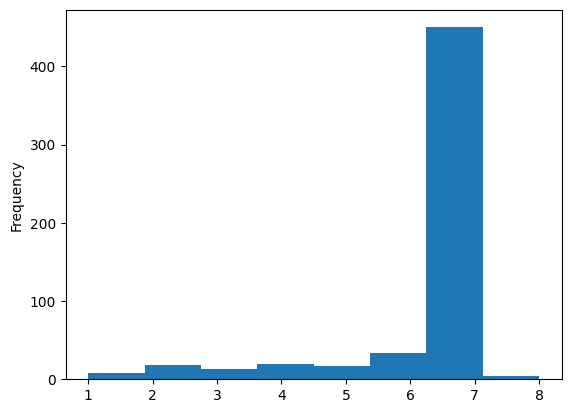

In [217]:
label_df['class'].plot.hist(bins=8)

Видно, что в не так много есть экземаляров выборки, где лейблов мало. Поэтому посмотрим на них, при случае исключим, чтобы помочь модели с обучением. Проблемы могут возникнуть на  groundtruth

Давайте оценим экземпляры, где лейблов мало

In [218]:
label_df[label_df['class'] < 5].count()

class    59
dtype: int64

In [219]:
images = []
for path in tqdm(train_paths[0]):
    file = path[0:-4].split('/')[-1][:-1]
    if file in label_df.index[:59]: # колчество лейблов до 5
        images += [draw_bb(path,train_df)]

100%|██████████| 563/563 [00:00<00:00, 1707.51it/s]


In [220]:
create_animation(images)

После просмотра изображений, можно сказать, что из первых 59, многие размечены плохо, кроме картинок под номерами [0,5, 17]. Примем решение просто убрать из датасета все картинки с лейблами меньше 4. Среди них присутствуют и слишком плохого качества, чтобы я, как человек мог там что-то классифицировать, что размечено не было.

In [221]:
label_df[label_df['class'] < 4].count()

class    39
dtype: int64

In [222]:
drop_val = 39

In [223]:
label_df = label_df.reset_index()
label_df.head()

,file,class
0,ckn7b6r4l00yl3068q1j4z9v5,1
1,ckie8dri1006k246ad5klxch2,1
2,ckn77x5i800lb3068tgwvgl9j,1
3,ckifm2pr9009u246a9d113o4t,1
4,ckn776r7o00ec3068iv66v1aa,1


In [224]:
train_df.shape

(3628, 6)

In [225]:
train_df.drop(train_df[train_df['file'].isin(label_df.iloc[:drop_val]['file'])].index,inplace=True)
train_df.shape

(3545, 6)

In [226]:
ind = [i for i, path in enumerate(train_paths[0]) if get_file_name(path) in label_df[:drop_val]['file'].tolist()]
tmp = (
        [ele for i, ele in enumerate(train_paths[0]) if i not in ind],
        [ele for i, ele in enumerate(train_paths[1]) if i not in ind],
        [ele for i, ele in enumerate(train_paths[2]) if i not in ind]
)
train_paths = tmp
len(train_paths[0])

524

In [227]:
len(ind)

39

Проверим датасет

<Axes: ylabel='Frequency'>

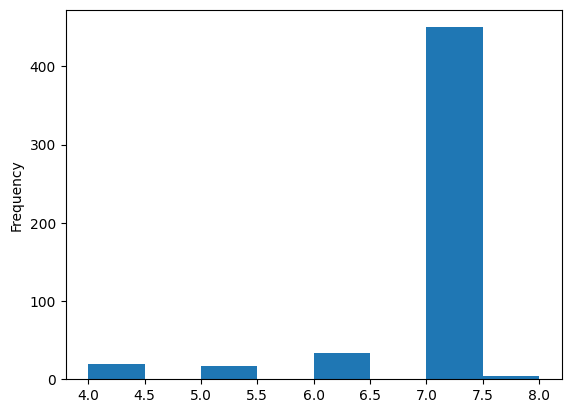

In [228]:
train_df.groupby(['file']).agg({'class':'count'}).sort_values(by=['class'],axis=0)['class'].plot.hist(bins=8)

Изображения с малым количеством лейблов удалены

### Cтороны и их отношения

Давайте попробуем оценить стороны картинок и их соотношение

In [229]:
def add_shape_info(df,ipaths):
    
    for path in tqdm(ipaths):
        image = cv2.imread(path)
        file = get_file_name(path)
        H,W = image.shape[0], image.shape[1]
        df.loc[df['file']==file, 'H'] = H
        df.loc[df['file']==file, 'W'] = W
        df.loc[df['file']==file, 'HW_ratio'] = H / W
    return df

In [230]:
test_df = add_shape_info(test_df,test_paths[0])

100%|██████████| 30/30 [00:00<00:00, 321.12it/s]


In [231]:
train_df = add_shape_info(train_df,train_paths[0])

100%|██████████| 524/524 [00:02<00:00, 207.96it/s]


In [232]:
train_df.shape

(3545, 9)

Так как у нас для одной картинки есть повторяющиеся названия, учитывать их не будем.

Отбросим все строки с дублирующимся названием файла

In [233]:
test_df.drop_duplicates('file').head()

,class,x_centre,y_centre,x_width,y_height,file,H,W,HW_ratio
0,6,0.085670,0.493631,0.096573,0.859873,ckicup6z1000g246a7fphj2ry,157.0,321.0,0.489097
7,5,0.100385,0.465982,0.086923,0.631579,ckicv7bge000i246amogy2uak,779.0,1300.0,0.599231
14,5,0.117783,0.516204,0.083141,0.754630,ckicz5mvn001m246adc3vvpi8,216.0,433.0,0.498845
21,4,0.110831,0.524457,0.115869,0.788043,ckid0aey1002d246a4yttijxq,184.0,397.0,0.463476
28,6,0.095116,0.521053,0.092545,0.757895,ckie431xs003u246amh9uo6cv,190.0,389.0,0.488432


In [234]:
train_df.drop_duplicates('file')[['H','W','HW_ratio']].describe()

,H,W,HW_ratio
count,524.000000,524.000000,524.000000
mean,143.698473,275.124046,0.574070
std,125.032037,255.471300,0.147103
min,26.000000,52.000000,0.202479
25%,61.000000,97.000000,0.491814
50%,93.000000,144.000000,0.546344
75%,201.000000,399.000000,0.672175
max,1303.000000,2506.000000,1.282051


Наша средняя картинка имеет размер 144 на 275

Построим гистограммы

<Axes: ylabel='Frequency'>

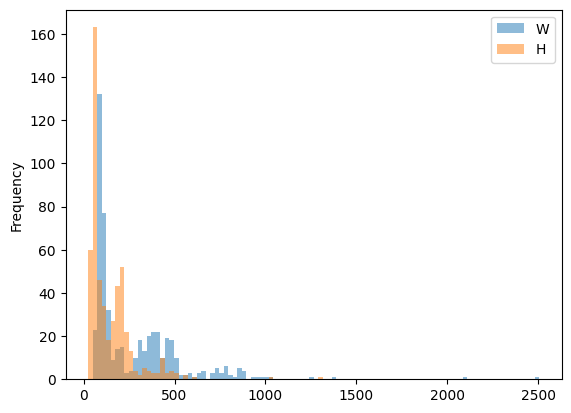

In [235]:
train_df.drop_duplicates('file')[['W','H']].plot.hist(bins=100,alpha=0.5)

<Axes: ylabel='Frequency'>

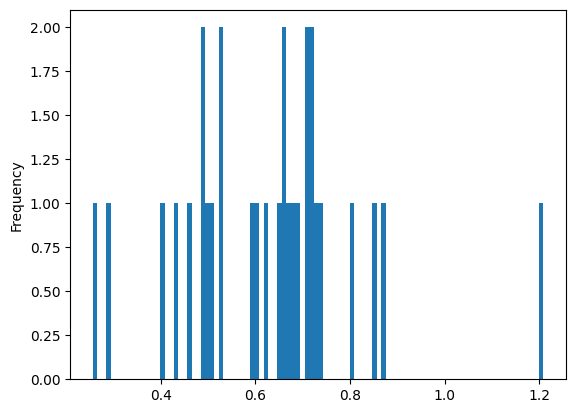

In [236]:
test_df.drop_duplicates('file')['HW_ratio'].plot.hist(bins=100)

<Axes: ylabel='Frequency'>

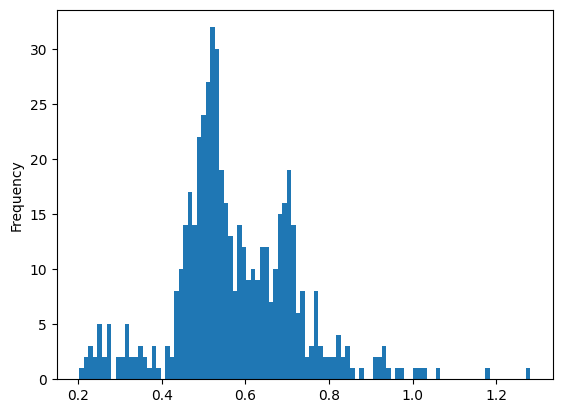

In [237]:
train_df.drop_duplicates('file')['HW_ratio'].plot.hist(bins=100)

Видно, что в основном отношение высоты к ширине около 0.5

Разброс достаточно велик, а значит стоит как-то преобразовать(или откинуть) выделяющиеся изображения так, чтобы при обучении они не мешали.

Наблюдается бимодальность

Можно добавить паддинг (в yolov8 он добавляется автоматически)  и поменять размер входного изображения на около средний (с другой стороны в yolov8 есть параметр, который создает мозайку из изображений) 

Для тестовой выборки что-то с уверенностью сказать сложно

# Оценим баланс классов

<Axes: ylabel='Frequency'>

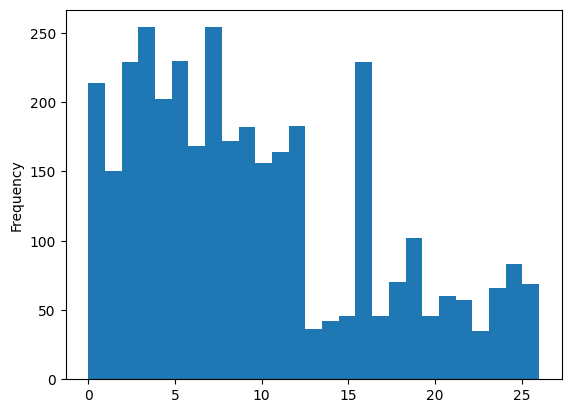

In [238]:
train_df['class'].plot.hist(bins=27)

In [239]:
train_df['class'].value_counts()

class
7     254
3     254
5     230
16    229
2     229
0     214
4     202
12    183
9     182
8     172
6     168
11    164
10    156
1     150
19    102
25     83
18     70
26     69
24     66
21     60
22     57
17     46
20     46
15     46
14     42
13     36
23     35
Name: count, dtype: int64

Видно, что присутствует некоторый дисбаланс классов.

Наименьшее количество в классах 13 и 23

Объектов в классе с цифрами больше, чем с буквами

In [240]:
train_df['class'].describe()

count    3545.000000
mean        9.526093
std         7.131897
min         0.000000
25%         4.000000
50%         8.000000
75%        15.000000
max        26.000000
Name: class, dtype: float64

# Оценка на bb

Оценим стороны, их соотношения и площадь bb и нормированных bb

In [241]:
def add_bb_square(ipath,df):
    colors = get_colors()
    image = cv2.imread(ipath)
    H,W = image.shape[0], image.shape[1]
    file = get_file_name(ipath)
    if df[df['file']==file] is not None:
        box = df[df['file']==file]
        box = box.reset_index(drop=True)  
        for i in range(len(box)):
            x = box.iloc[i]['x_centre']
            y = box.iloc[i]['y_centre']
            w = box.iloc[i]['x_width']
            h = box.iloc[i]['y_height']
            x0 = ((x-w/2)*W).astype(int)
            y0 = ((y-h/2)*H).astype(int)
            x1 = ((x+w/2)*W).astype(int)
            y1 = ((y+h/2)*H).astype(int)
            df.loc[(df['file'] == file) & (df['class'] == box.iloc[i]['class']), 'bb_square'] = (x1 - x0) * (y1 - y0)
    return df

In [242]:
train_df['bb_square'] = 0

In [243]:
for path in tqdm(train_paths[0]):
    train_df = add_bb_square(path,train_df)

100%|██████████| 524/524 [00:07<00:00, 67.84it/s]


<Axes: ylabel='Frequency'>

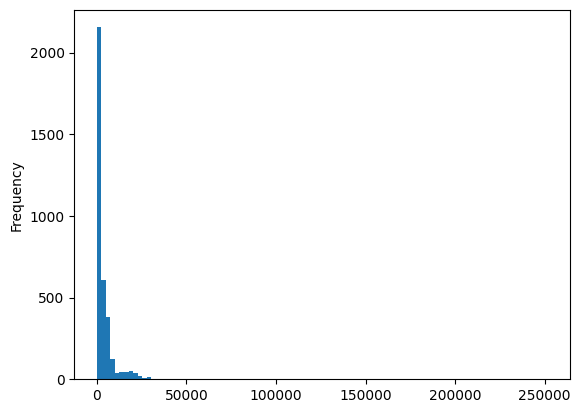

In [244]:
train_df['bb_square'].plot.hist(bins=100)

In [245]:
train_df['bb_square'].describe()

count      3545.000000
mean       3938.973202
std       11738.400145
min           2.000000
25%         360.000000
50%         765.000000
75%        4556.000000
max      251804.000000
Name: bb_square, dtype: float64

<Axes: ylabel='Frequency'>

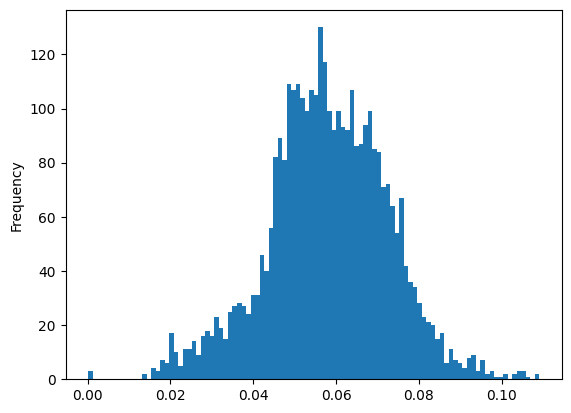

In [246]:
train_df['norm_bb_square'] = train_df['x_width'] * train_df['y_height']
train_df['norm_bb_square'].plot.hist(bins=100)

In [247]:
train_df['norm_bb_square'].describe()

count    3545.000000
mean        0.057951
std         0.014638
min         0.000161
25%         0.048982
50%         0.057736
75%         0.068015
max         0.109010
Name: norm_bb_square, dtype: float64

Средний bb - 6% от изображения

Если смотреть на нормализированную площадь bb, то проблем быть не должно

Одна мода, достаточно маленькая дисперсия.

С ненормализированной сложнее. В ней присутствуют выбросы. Но она все еще имеет одну моду. 
С учетом того, что изображения будут сжиматься(resize) до примерно одного значения. Эта проблема не должна сильно влиять


In [248]:
train_df['bb_ratio'] = train_df['x_width'] / train_df['y_height']

In [249]:
train_df['bb_ratio'].describe()

count    3545.000000
mean        0.144426
std         0.039924
min         0.047645
25%         0.117018
50%         0.136962
75%         0.169141
max         0.709677
Name: bb_ratio, dtype: float64

<Axes: ylabel='Frequency'>

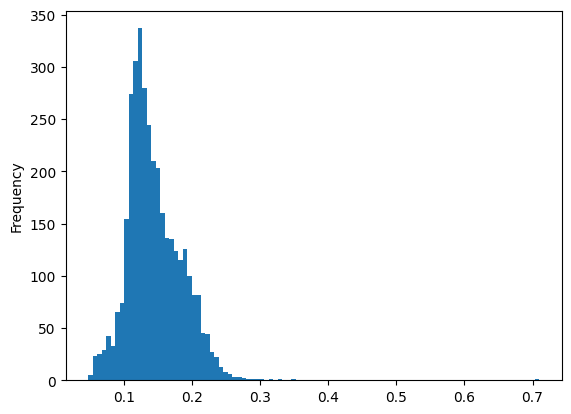

In [250]:
train_df['bb_ratio'].plot.hist(bins=100)

Видно, что отношение нормированных сторон имеет одну моду, примерно 0,15


И не слишком большую дисперсию, а значит bb имеют примерно одинаковую форму, что хорошо скажется на обучение при resize

In [251]:
train_df.head()

,class,x_centre,y_centre,x_width,y_height,file,H,W,HW_ratio,bb_square,norm_bb_square,bb_ratio
0,0,0.114880,0.563636,0.041575,0.618182,ckictsenl0000246a2itn28ts,110.0,457.0,0.2407,1311,0.025701,0.067254
1,5,0.198031,0.527273,0.041575,0.672727,ckictsenl0000246a2itn28ts,110.0,457.0,0.2407,1332,0.027969,0.061801
2,2,0.288840,0.495455,0.048140,0.754545,ckictsenl0000246a2itn28ts,110.0,457.0,0.2407,1764,0.036324,0.063800
3,8,0.378556,0.490909,0.048140,0.745455,ckictsenl0000246a2itn28ts,110.0,457.0,0.2407,1782,0.035886,0.064578
4,18,0.589716,0.504545,0.054705,0.736364,ckictsenl0000246a2itn28ts,110.0,457.0,0.2407,2050,0.040282,0.074290


# Разделение на выборки

In [60]:
!rm -rf datasets

Создадим директории

In [61]:
os.makedirs('datasets', exist_ok=True)
os.makedirs('datasets/train', exist_ok=True)
os.makedirs('datasets/valid', exist_ok=True)
os.makedirs('datasets/test', exist_ok=True)

In [62]:
copy_tree('/kaggle/input/ksa-number-plates1/KSA Number Plates/test', '/kaggle/working/datasets/test')
None

Выберем валидационую выборку, так чтобы там присутствовали все классы и лучше, если примерно также сбалансированы

Возьмем классические 80/20 на train/valid датасеты

<Axes: ylabel='Frequency'>

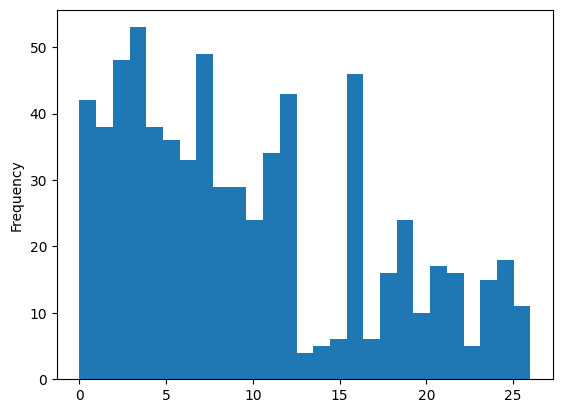

In [63]:
val_shift = 230
val_size = int(len(train_paths[0])*0.2)
val_elems = []
for path in train_paths[0][val_shift:val_size+val_shift]:
    val_elems.append(get_file_name(path))
len(val_elems)
train_df.loc[train_df['file'].isin(val_elems)]['class'].plot.hist(bins=27)
#train_df.loc[train_df['file'].isin(val_elems)]['class'].value_counts()

In [64]:
train_df.loc[train_df['file'].isin(val_elems)]['class'].value_counts()

class
3     53
7     49
2     48
16    46
12    43
0     42
4     38
1     38
5     36
11    34
6     33
8     29
9     29
10    24
19    24
25    18
21    17
22    16
18    16
24    15
26    11
20    10
15     6
17     6
14     5
23     5
13     4
Name: count, dtype: int64

In [175]:
len(val_elems)

104

In [66]:
for i in range(len(train_paths[0])):
    ifile = train_paths[0][i].split('/')[-1]
    tfile = train_paths[1][i].split('/')[-1]
    ipath = train_paths[0][i]
    tpath = train_paths[1][i]
    if get_file_name(train_paths[0][i]) not in val_elems:
        copyfile(ipath, f'datasets/train/{ifile}')
        copyfile(tpath, f'datasets/train/{tfile}')
    else:
        copyfile(ipath, f'datasets/valid/{ifile}')
        copyfile(tpath, f'datasets/valid/{tfile}')

Сформируем yaml файл

In [67]:
N=list(range(27))
Name=[]
for i in range(27):
    Name+=[str(i).zfill(2)]
class_map=dict(zip(N,Name))  
class_map

{0: '00',
 1: '01',
 2: '02',
 3: '03',
 4: '04',
 5: '05',
 6: '06',
 7: '07',
 8: '08',
 9: '09',
 10: '10',
 11: '11',
 12: '12',
 13: '13',
 14: '14',
 15: '15',
 16: '16',
 17: '17',
 18: '18',
 19: '19',
 20: '20',
 21: '21',
 22: '22',
 23: '23',
 24: '24',
 25: '25',
 26: '26'}

In [68]:
plate_yaml = dict(
    train = 'train',
    val = 'valid',
    test = 'test',
    nc = 27,
    names = Name,
)

with open('plate.yaml', 'w') as outfile:
    yaml.dump(plate_yaml, outfile, default_flow_style=True)
    
!cat plate.yaml

{names: ['00', '01', '02', '03', '04', '05', '06', '07', 08, 09, '10', '11', '12',
    '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25',
    '26'], nc: 27, test: test, train: train, val: valid}


# Обучение

In [69]:
print('hello!')

hello!


In [70]:
!rm -rf runs
!rm -rf yolov8x.pt
!rm -rf yolov8n.pt

In [71]:
!rm -rf yolo_detection

Воспользуемся моделью yoloV8.
Она имеет встроенный тренер, даталоудер, и позволяет применять к данным аугментацию.

In [72]:
model = YOLO("yolov8x.pt") 

100%|██████████| 131M/131M [00:00<00:00, 250MB/s] 


Добавим некоторую аугментацию в параметрах модели 
https://docs.ultralytics.com/usage/cfg/#augmentation

Из аугментаций добавим 
- повороты,так как знаки расположены не прямо
- случайные вставки
- наложение

В самой yolo по умолчанию также есть смазывание и несколько других техник

In [73]:
!yolo task=detect mode=train model=yolov8x.pt data=plate.yaml epochs=40 imgsz=512 degrees=10 mixup=0.1 copy_paste=0.05 close_mosaic=5 project='yolo_detection' name='train' 

Ultralytics YOLOv8.1.3 🚀 Python-3.10.12 torch-2.0.0 CUDA:0 (Tesla P100-PCIE-16GB, 16276MiB)
engine/trainer: task=detect, mode=train, model=yolov8x.pt, data=plate.yaml, epochs=40, time=None, patience=50, batch=16, imgsz=500, save=True, save_period=-1, cache=False, device=None, workers=8, project=yolo_detection, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=5, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_box

Loss падает mAP растет, модель обучается.

 # Метрики на валидационной выборке

Confidence Score = Pr(Object) * IoU(pred, truth)

Class confidence:
C_i = Pr(Class_i|Object) * Pr(Object) * IoU(pred, truth)

In [74]:
res_paths = []
for dirname, _, filenames in os.walk('/kaggle/working/yolo_detection/train'):
    for filename in filenames:
        if filename[-4:] == '.png' or filename[-4:] == '.jpg':
            res_paths+=[(os.path.join(dirname, filename))]
res_paths=sorted(res_paths)
print(len(res_paths))

21


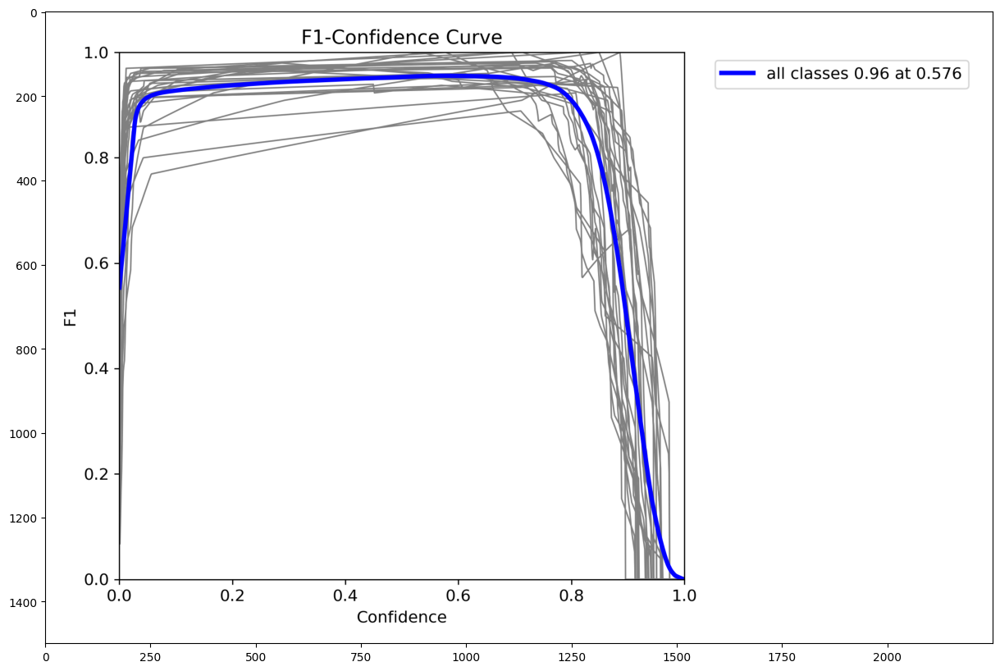

In [75]:
image=np.array(Image.open(res_paths[0]))
plt.figure(figsize=(20,10))
plt.imshow(image)

f1-confidence показывает, что модель обучилась нормально.

Но несколько классов показывают чуть худшие показатели. Вспомним, что наша выборка была несбалансированной. Скорее всего это повлияло.

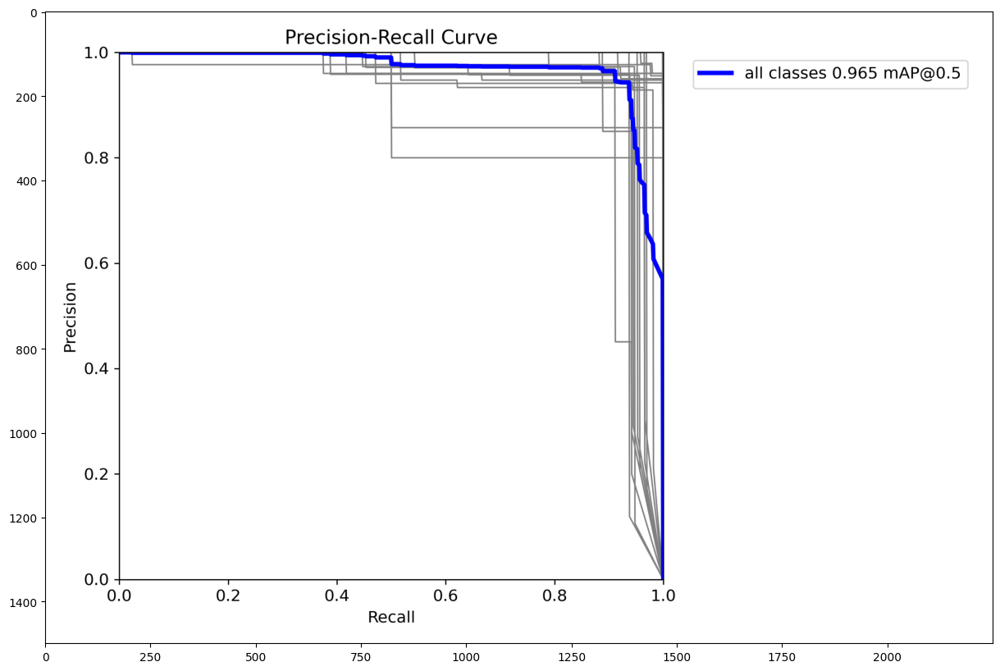

In [76]:
image=np.array(Image.open(res_paths[1]))
plt.figure(figsize=(20,10))
plt.imshow(image)

precision-recall curve показывает нам, что модель обучилась в целом хорошо. Но есть несколько классов, с которыми ей трудно. Вероятнее всего это проистекает из несбалансированности выборки

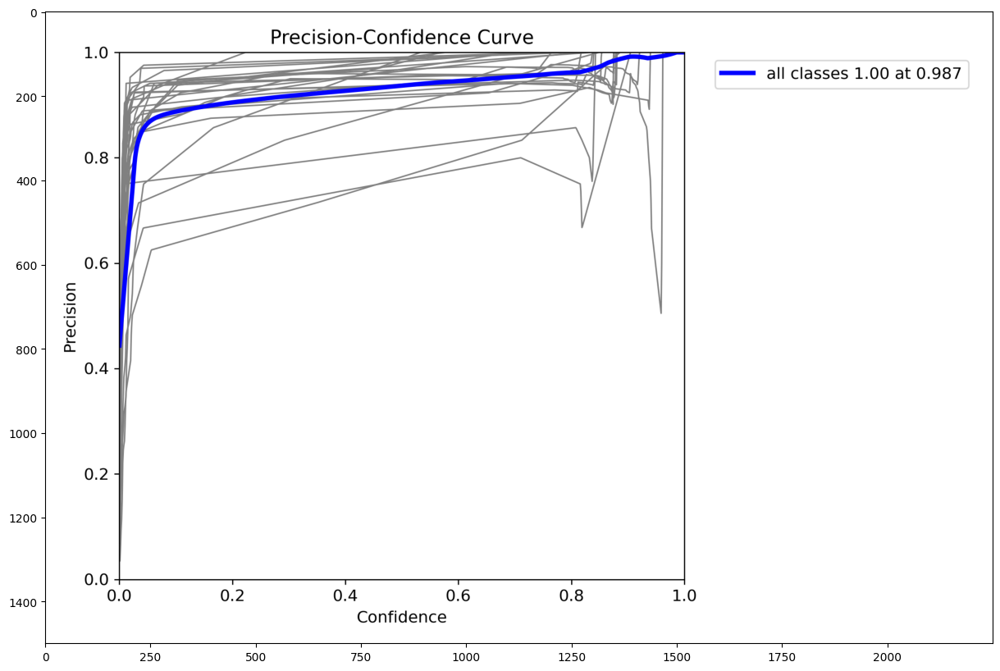

In [77]:
image=np.array(Image.open(res_paths[2]))
plt.figure(figsize=(20,10))
plt.imshow(image)

Также и на precision-conf. Несколько классов выделяет хуже других. Это в том числе и те классы, которые были меньше всего представлены

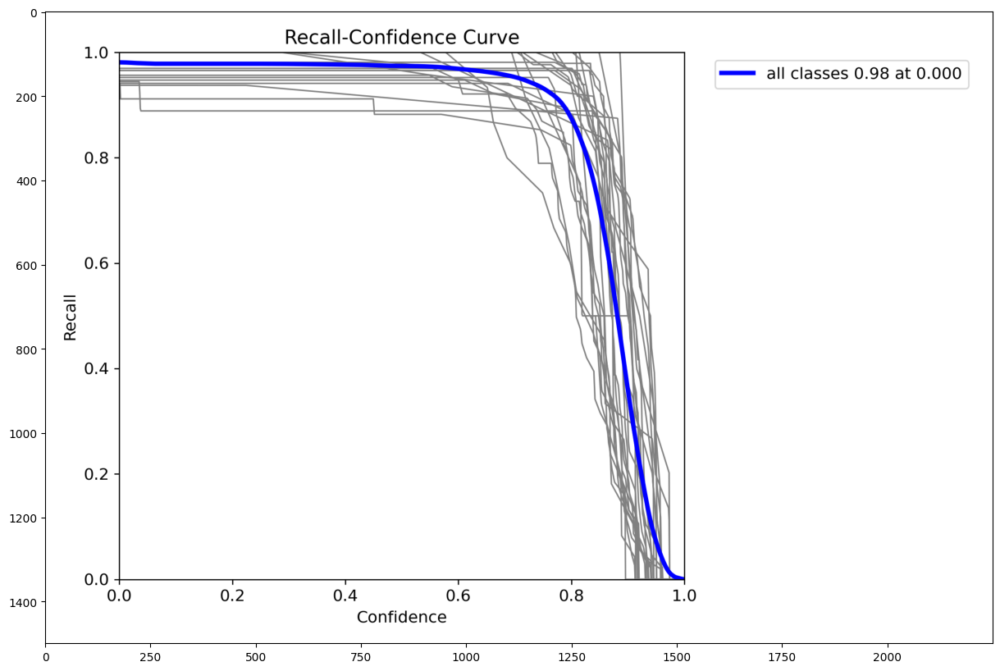

In [78]:
image=np.array(Image.open(res_paths[3]))
plt.figure(figsize=(20,10))
plt.imshow(image)

Судя по метрике один класс выделяется не слишком хорошо.

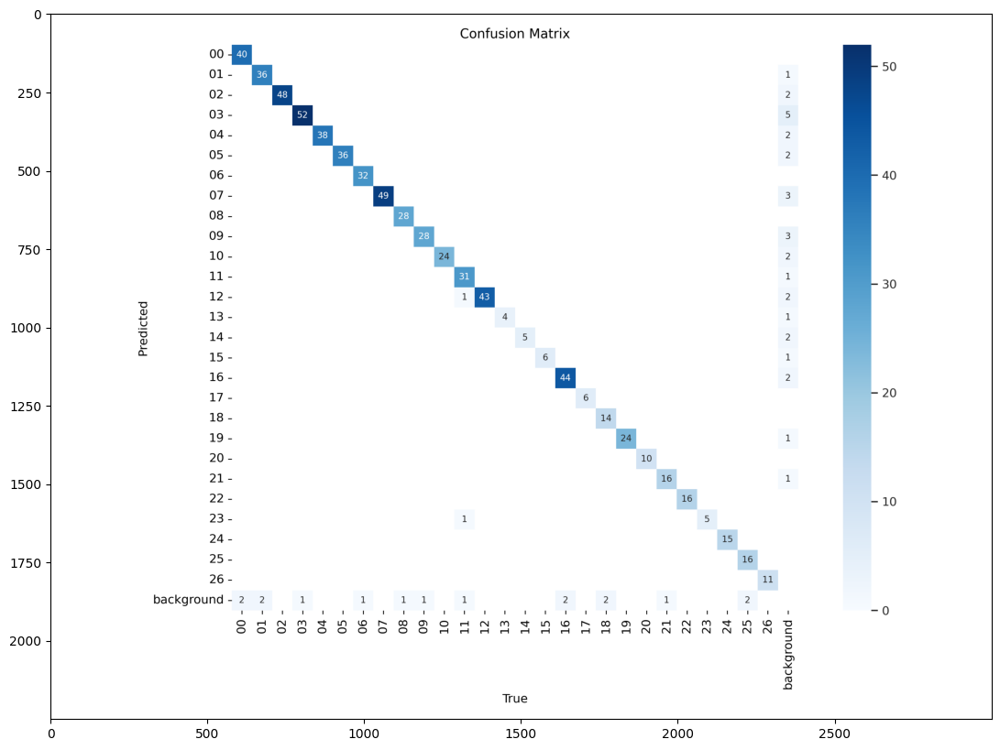

In [79]:
image=np.array(Image.open(res_paths[4]))
plt.figure(figsize=(20,10))
plt.imshow(image)

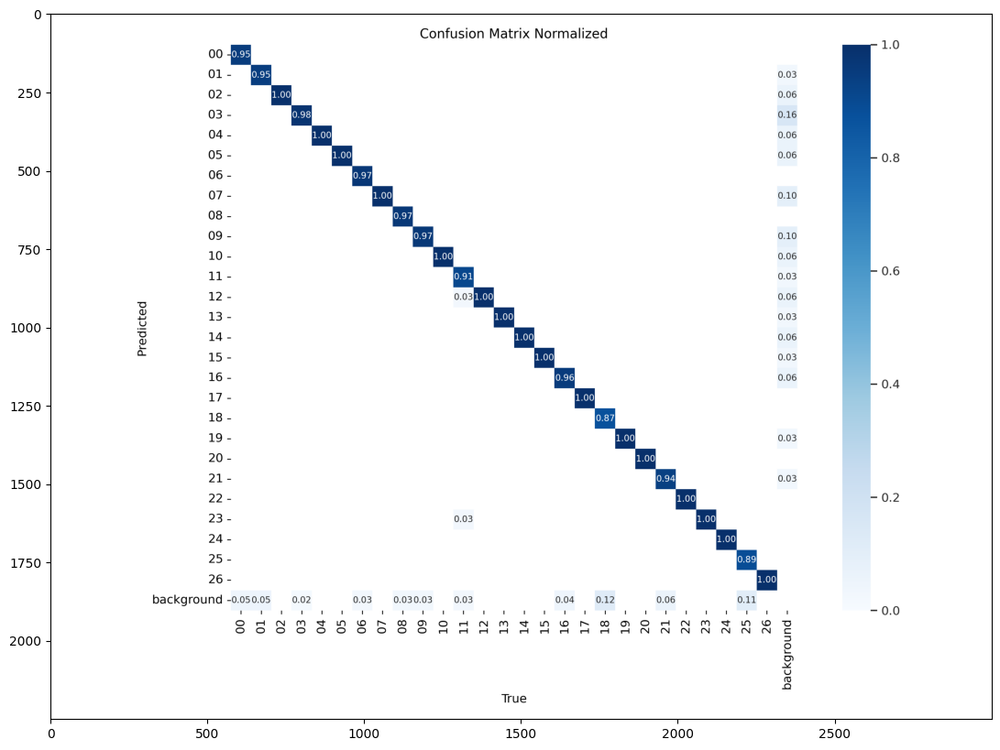

In [80]:
image=np.array(Image.open(res_paths[5]))
plt.figure(figsize=(20,10))
plt.imshow(image)

Присутствуют ложные срабатывания, когда модель путает задний фон с классом
Между классами модель почти не ошибается

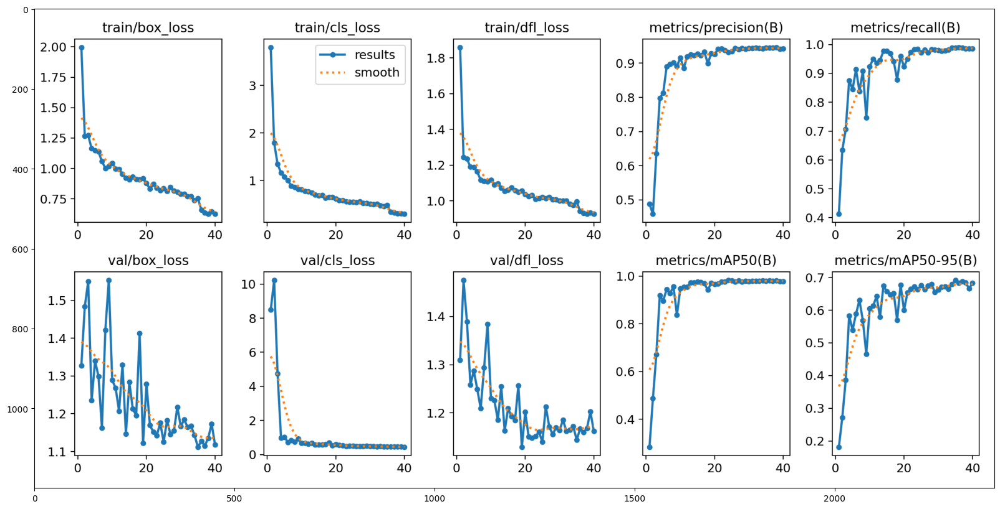

In [81]:
image=np.array(Image.open(res_paths[8]))
plt.figure(figsize=(20,10))
plt.imshow(image)

Эти метрики еще раз говорят о том, что модель обучилась
Ниже приведены несколько примеров входных данных

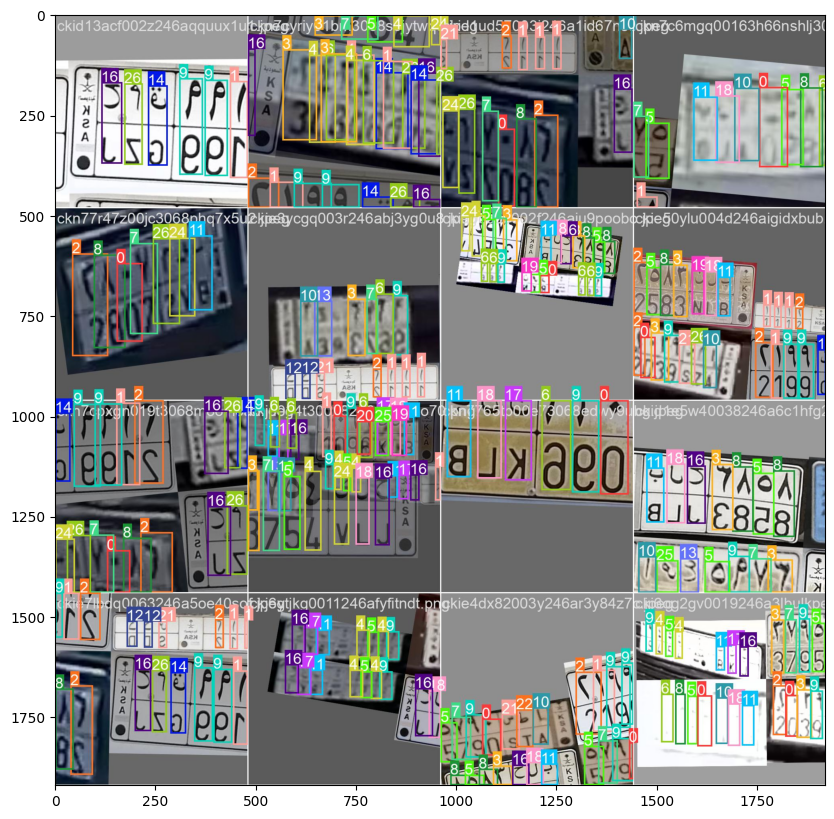

In [82]:
image=np.array(Image.open(res_paths[11]))
plt.figure(figsize=(20,10))
plt.imshow(image)

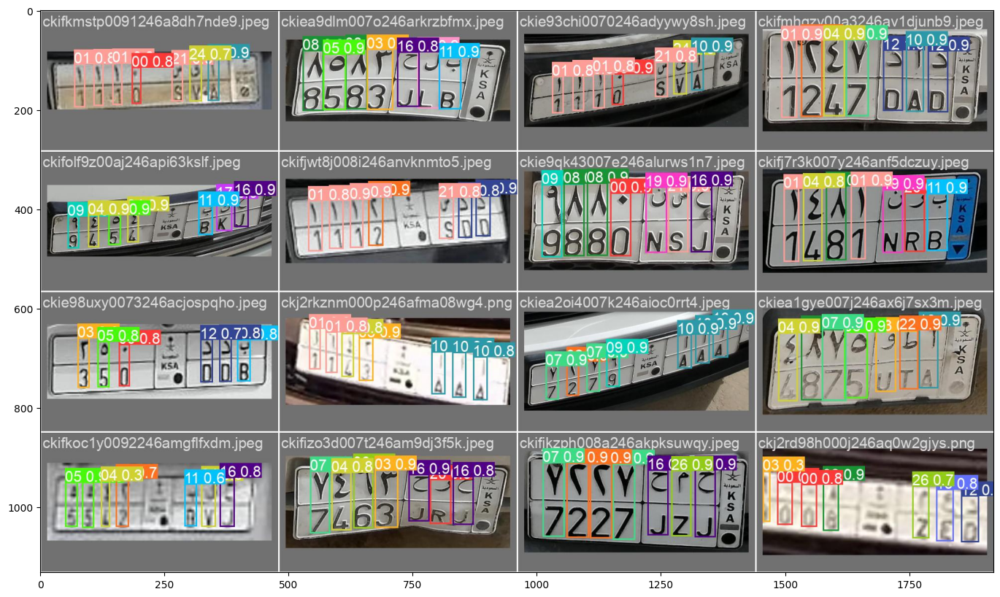

In [83]:
image=np.array(Image.open(res_paths[16]))
plt.figure(figsize=(20,10))
plt.imshow(image)

# Метрики на тестовой выборке 

In [166]:
plate_yaml_1 = dict(
    train = 'train',
    val = 'test',
    test = 'valid',
    nc = 27,
    names = Name,
)

with open('plate_1.yaml', 'w') as outfile:
    yaml.dump(plate_yaml_1, outfile, default_flow_style=True)
    
!cat plate_1.yaml

{names: ['00', '01', '02', '03', '04', '05', '06', '07', 08, 09, '10', '11', '12',
    '13', '14', '15', '16', '17', '18', '19', '20', '21', '22', '23', '24', '25',
    '26'], nc: 27, test: valid, train: train, val: test}


In [150]:
best_path0='yolo_detection/train/weights/best.pt'
source0='datasets/test'

In [167]:
!rm -rf yolo_detection/valid
!rm -rf yolo_detection/valid1
!rm -rf yolo_detection/valid2
!rm -rf yolo_detection/valid3

In [168]:
!rm -rf /kaggle/working/datasets/valid.cache

In [169]:
!yolo task=detect mode=val model='/kaggle/working/yolo_detection/train/weights/best.pt' data=plate_1.yaml project='yolo_detection' name='valid' 

Ultralytics YOLOv8.1.3 🚀 Python-3.10.12 torch-2.0.0 CUDA:0 (Tesla P100-PCIE-16GB, 16276MiB)
Model summary (fused): 268 layers, 68149569 parameters, 0 gradients, 257.5 GFLOPs
val: Scanning /kaggle/working/datasets/test... 30 images, 0 backgrounds, 0 corru
val: New cache created: /kaggle/working/datasets/test.cache
                 Class     Images  Instances      Box(P          R      mAP50  m
                   all         30        199      0.939      0.972      0.974      0.768
                    00         30          5      0.976          1      0.995      0.739
                    01         30          2      0.843          1      0.995      0.597
                    02         30         12      0.917       0.92      0.976      0.723
                    03         30         12      0.847          1      0.972      0.756
                    04         30         17      0.967          1      0.995      0.749
                    05         30         21      0.997          1    

In [171]:
res_paths = []
for dirname, _, filenames in os.walk('yolo_detection/valid'):
    for filename in filenames:
        if filename[-4:] == '.png' or filename[-4:] == '.jpg' or filename[-4:] == 'jpeg':
            res_paths+=[(os.path.join(dirname, filename))]
res_paths=sorted(res_paths)
print(len(res_paths))

10


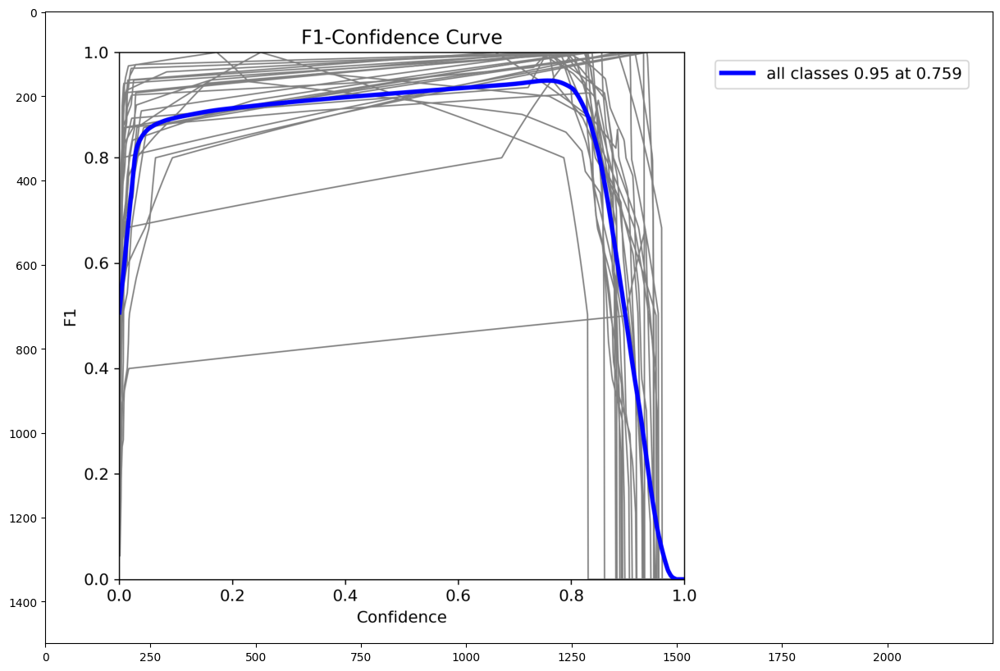

In [172]:
image=np.array(Image.open(res_paths[0]))
plt.figure(figsize=(20,10))
plt.imshow(image)

Модель детектирует один класс сильно хуже остальных.
В целом модель работает достаточно хорошо


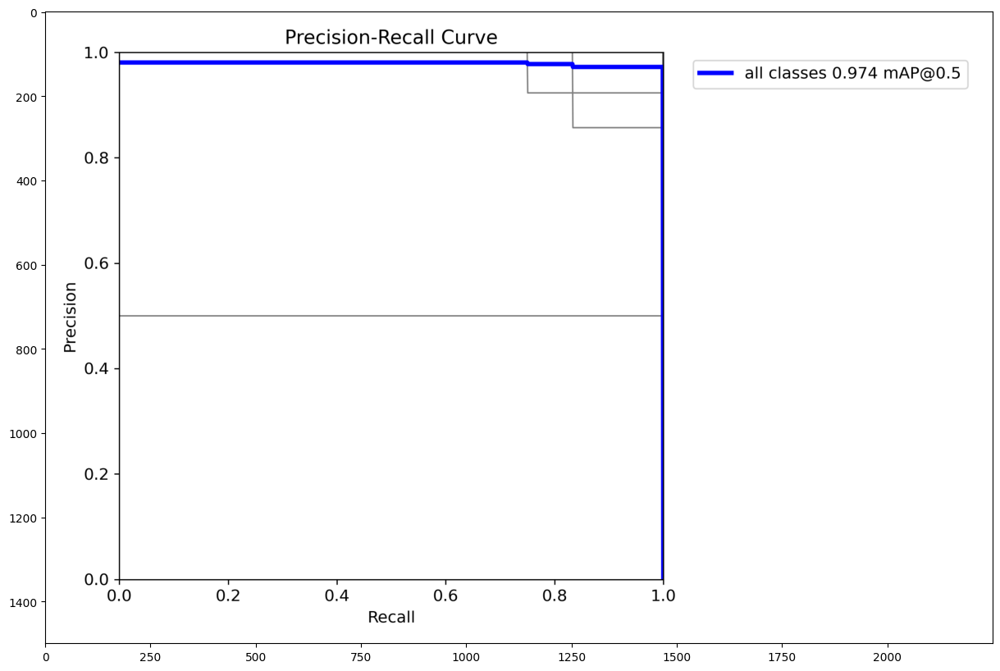

In [173]:
image=np.array(Image.open(res_paths[1]))
plt.figure(figsize=(20,10))
plt.imshow(image)

Один класс определяется хуже остальных.
В остальном модель классифицирует достаточно хорошо

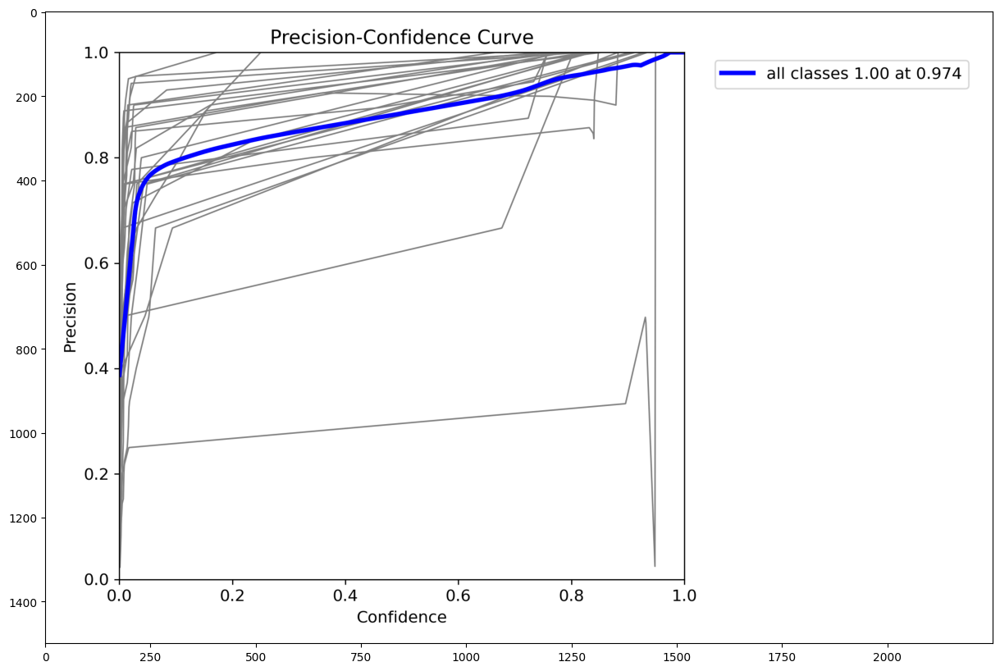

In [178]:
image=np.array(Image.open(res_paths[2]))
plt.figure(figsize=(20,10))
plt.imshow(image)

С сегментацией модель справляется достаточно хорошо, но один класс выделить ей все-таки не удается

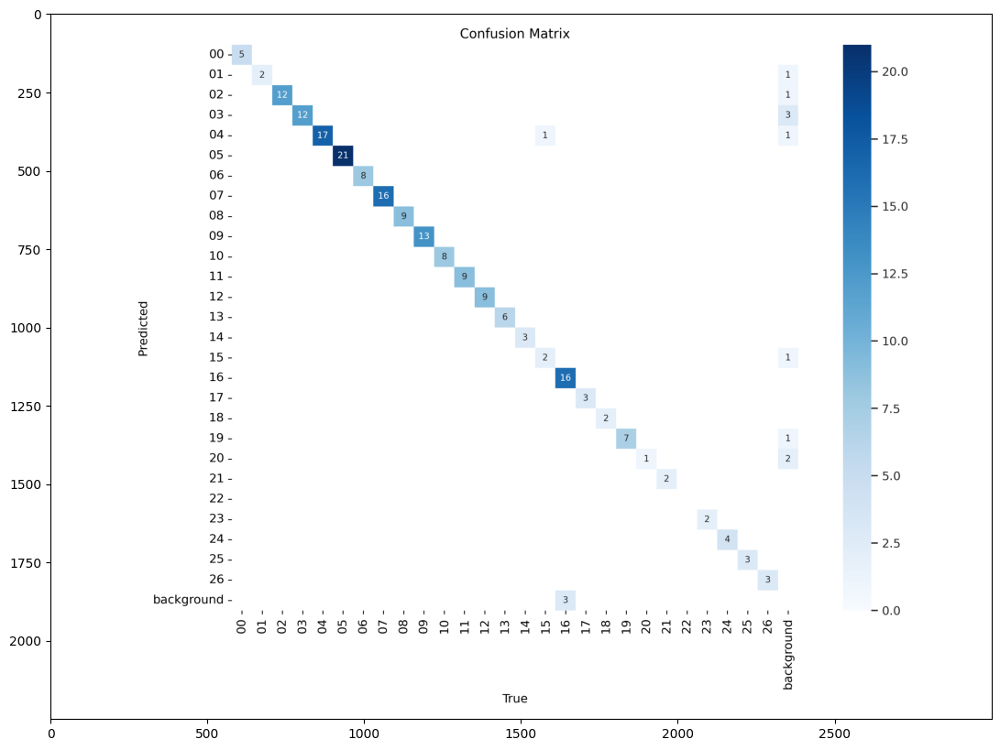

In [180]:
image=np.array(Image.open(res_paths[4]))
plt.figure(figsize=(20,10))
plt.imshow(image)

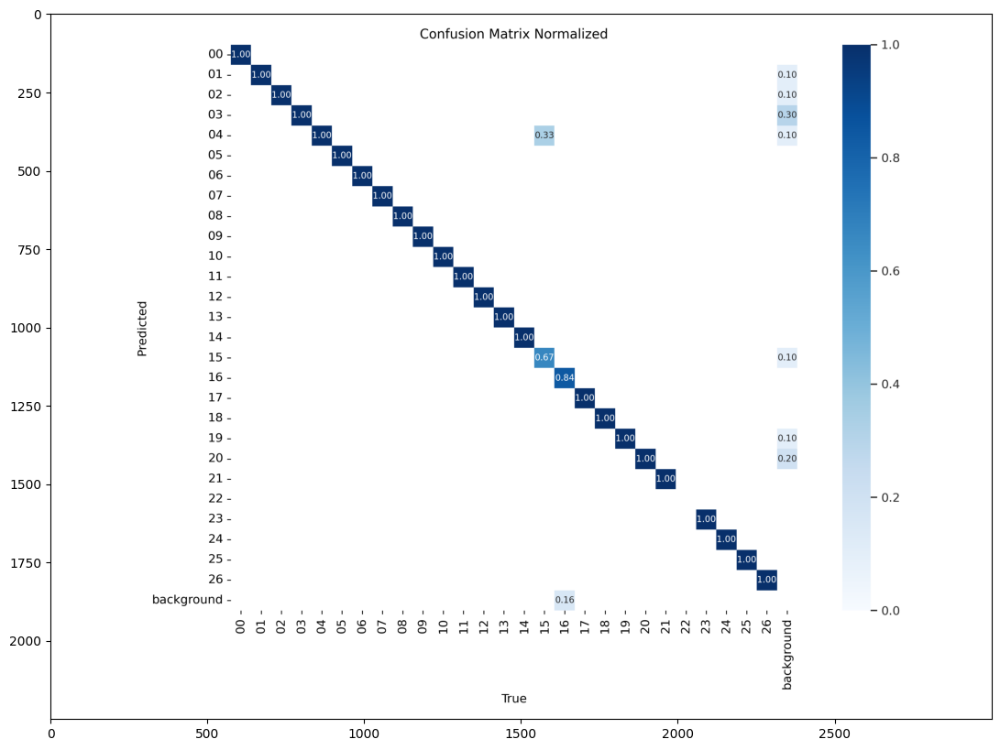

In [181]:
image=np.array(Image.open(res_paths[5]))
plt.figure(figsize=(20,10))
plt.imshow(image)

Существуют проблема, когда модел выделяет объект там, где объектов вообще нет

Модель плохо справляет с классом 15

При этом путаницы между классами не обнаружено

Ниже примеры детекции на тестовой выборке

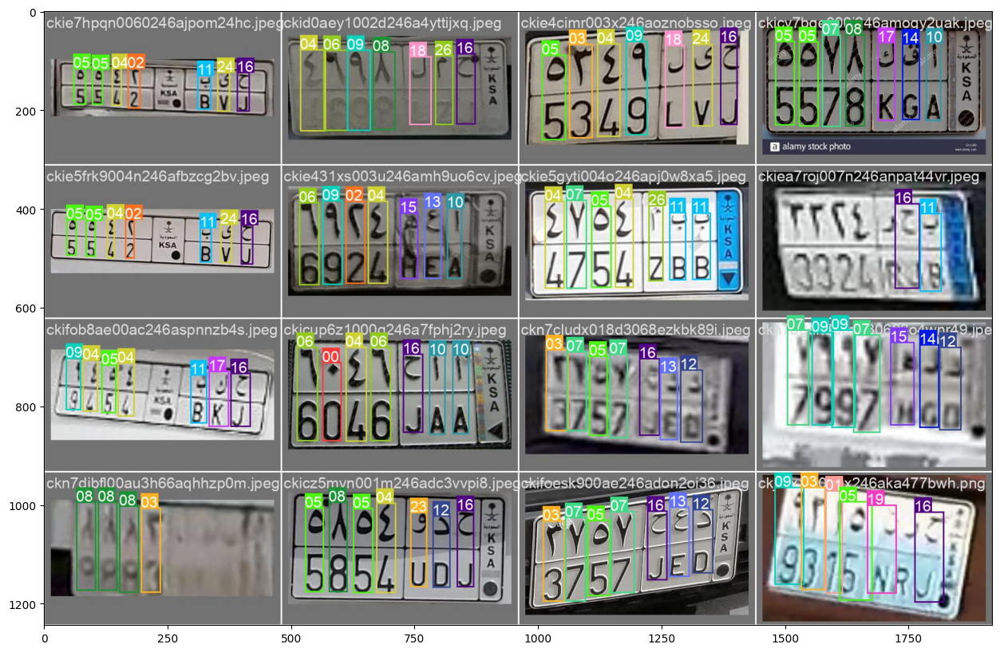

In [182]:
image=np.array(Image.open(res_paths[6]))
plt.figure(figsize=(20,10))
plt.imshow(image)

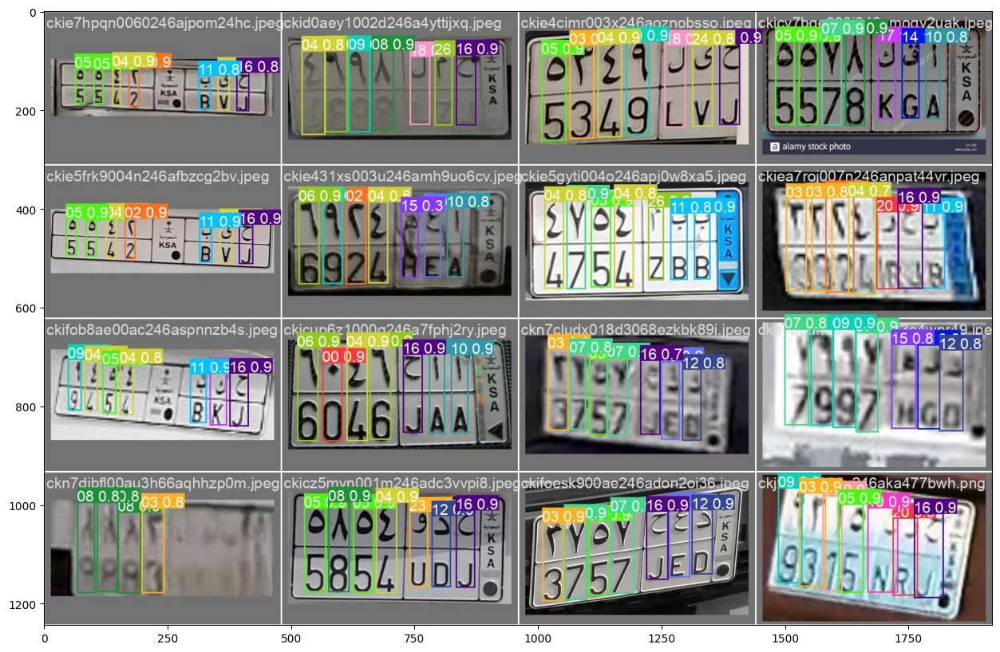

In [184]:
image=np.array(Image.open(res_paths[7]))
plt.figure(figsize=(20,10))
plt.imshow(image)

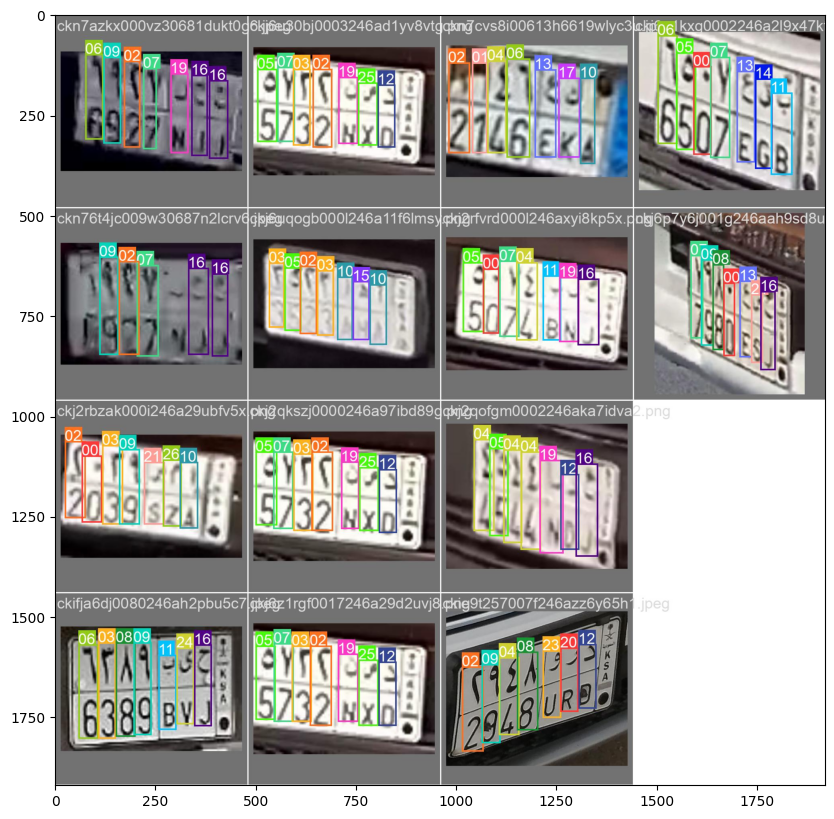

In [185]:
image=np.array(Image.open(res_paths[8]))
plt.figure(figsize=(20,10))
plt.imshow(image)

### посмотрим возможные ошибки

In [186]:
!rm -rf runs
!rm -rf yolo_detection/test

In [187]:
model2 = YOLO(best_path0)

In [188]:
results = model2.predict(source=source0, conf=0.6, iou=0.5,save_conf=True,save=True,project='yolo_detection',name='test')
print(len(results))


image 1/30 /kaggle/working/datasets/test/ckicup6z1000g246a7fphj2ry.jpeg: 256x512 1 00, 1 04, 2 06s, 2 10s, 1 16, 83.1ms
image 2/30 /kaggle/working/datasets/test/ckicv7bge000i246amogy2uak.jpeg: 320x512 2 05s, 1 07, 1 08, 1 10, 1 14, 1 17, 66.6ms
image 3/30 /kaggle/working/datasets/test/ckicz5mvn001m246adc3vvpi8.jpeg: 256x512 1 04, 2 05s, 1 08, 1 12, 1 16, 1 23, 19.4ms
image 4/30 /kaggle/working/datasets/test/ckid0aey1002d246a4yttijxq.jpeg: 256x512 1 04, 1 06, 1 08, 1 09, 1 16, 1 18, 1 26, 18.8ms
image 5/30 /kaggle/working/datasets/test/ckie431xs003u246amh9uo6cv.jpeg: 256x512 1 02, 1 04, 1 06, 1 09, 1 10, 1 13, 1 15, 18.8ms
image 6/30 /kaggle/working/datasets/test/ckie4cimr003x246aoznobsso.jpeg: 288x512 1 03, 1 04, 1 05, 1 09, 1 16, 1 18, 1 24, 63.1ms
image 7/30 /kaggle/working/datasets/test/ckie5frk9004n246afbzcg2bv.jpeg: 160x512 1 02, 1 04, 2 05s, 1 11, 1 16, 1 24, 65.6ms
image 8/30 /kaggle/working/datasets/test/ckie5gyti004o246apj0w8xa5.jpeg: 288x512 2 04s, 1 05, 1 07, 2 11s, 1 26, 2

In [190]:
yolo_test_paths = []
for dirname, _, filenames in os.walk(source0):
    for filename in filenames:
        if filename[-4:] != '.xml' and filename[-4:] != '.txt':
            yolo_test_paths += [(os.path.join(dirname, filename))]
yolo_test_paths=sorted(yolo_test_paths)
yolo_test_paths

['datasets/test/ckicup6z1000g246a7fphj2ry.jpeg',
 'datasets/test/ckicv7bge000i246amogy2uak.jpeg',
 'datasets/test/ckicz5mvn001m246adc3vvpi8.jpeg',
 'datasets/test/ckid0aey1002d246a4yttijxq.jpeg',
 'datasets/test/ckie431xs003u246amh9uo6cv.jpeg',
 'datasets/test/ckie4cimr003x246aoznobsso.jpeg',
 'datasets/test/ckie5frk9004n246afbzcg2bv.jpeg',
 'datasets/test/ckie5gyti004o246apj0w8xa5.jpeg',
 'datasets/test/ckie7hpqn0060246ajpom24hc.jpeg',
 'datasets/test/ckie9t257007f246azz6y65h1.jpeg',
 'datasets/test/ckiea7roj007n246anpat44vr.jpeg',
 'datasets/test/ckifja6dj0080246ah2pbu5c7.jpeg',
 'datasets/test/ckifob8ae00ac246aspnnzb4s.jpeg',
 'datasets/test/ckifoesk900ae246adon2oi36.jpeg',
 'datasets/test/ckj2qkszj0000246a97ibd89g.png',
 'datasets/test/ckj2qofgm0002246aka7idva2.png',
 'datasets/test/ckj2rbzak000i246a29ubfv5x.png',
 'datasets/test/ckj2rfvrd000l246axyi8kp5x.png',
 'datasets/test/ckj2rx1lh000x246aka477bwh.png',
 'datasets/test/ckj6p7y6j001g246aah9sd8u9.png',
 'datasets/test/ckj6u1kxg0

In [191]:
yolo_test_df = pd.DataFrame(columns=range(6))
for i in range(len(results)):
    if results[26].boxes.data.shape[0] > 0:
        add = pd.DataFrame(results[i].boxes.data.cpu().numpy()).astype(np.float64)
        file = get_file_name(yolo_test_paths[i].split('/')[-1])
        add = add.assign(file=file)
        yolo_test_df = pd.concat([yolo_test_df,add],axis=0)
yolo_test_df.columns=['x','y','x2','y2','confidence','class','file']
yolo_test_df

/tmp/ipykernel_1585/3454634132.py:7: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  yolo_test_df = pd.concat([yolo_test_df,add],axis=0)


,x,y,x2,y2,confidence,class,file
0,116.105606,9.143216,149.797882,144.256165,0.930972,6.0,ckicup6z1000g246a7fphj2ry
1,47.342815,31.455969,80.134827,145.815796,0.906879,0.0,ckicup6z1000g246a7fphj2ry
2,9.470229,9.464806,45.232807,146.394287,0.903425,6.0,ckicup6z1000g246a7fphj2ry
3,199.134460,19.717358,226.367661,134.722504,0.899308,10.0,ckicup6z1000g246a7fphj2ry
4,163.584137,20.045712,194.078537,134.803528,0.898905,16.0,ckicup6z1000g246a7fphj2ry
...,...,...,...,...,...,...,...
6,18.156328,5.389614,29.183609,51.303356,0.771178,4.0,ckn7cvs8i00613h6619wlyc3u
0,33.564648,5.769867,46.378132,48.090515,0.882124,8.0,ckn7dibfl00au3h66aqhhzp0m
1,45.471043,3.692514,58.499233,48.038773,0.849551,3.0,ckn7dibfl00au3h66aqhhzp0m
2,22.726688,0.486952,35.294666,47.282402,0.843809,8.0,ckn7dibfl00au3h66aqhhzp0m


In [192]:
yolo_test_df['class'] = yolo_test_df['class'].apply(lambda x: class_map[int(x)])
yolo_test_df = yolo_test_df.reset_index(drop=True)
np.sort(yolo_test_df['class'].unique().astype(str))

array(['00', '01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '23', '24', '25', '26'], dtype='<U2')

In [193]:
def draw_bb_plain_coord(ipath,df,test_df):
    colors = get_colors()
    image = cv2.imread(ipath)
    H,W = image.shape[0],image.shape[1]
    file = get_file_name(ipath)
    if df[df['file']==file] is not None: 
        box = df[df['file']==file]
        box = box.reset_index(drop=True)  
        for i in range(len(box)):
            label = box.iloc[i]['class']
            x0 = int(box.iloc[i]['x'])
            y0 = int(box.iloc[i]['y'])
            x2 = int(box.iloc[i]['x2'])
            y2 = int(box.iloc[i]['y2'])
            ci=colors[int(label)%14]
            cv2.rectangle(image, (x0, y0), (x2, y2), ci, 2)
    
    if test_df[test_df['file']==file] is not None: 
        box = test_df[test_df['file']==file]
        box = box.reset_index(drop=True)  
        for i in range(len(box)):
            label = box.iloc[i]['class']
            x = box.iloc[i]['x_centre']
            y = box.iloc[i]['y_centre']
            w = box.iloc[i]['x_width']
            h = box.iloc[i]['y_height']
            x0 = ((x - w / 2) * W).astype(int)
            y0 = ((y - h / 2) * H).astype(int)
            x1 = ((x + w / 2) * W).astype(int)
            y1 = ((y + h / 2) * H).astype(int)
            ci = colors[int(label) % 14]
            cv2.rectangle(image, (x0, y0), (x1, y1), ci, 1)
        
    return image

In [194]:
images2=[]
for path in tqdm(yolo_test_paths):
    images2+=[draw_bb_plain_coord(path,yolo_test_df,test_df)]

100%|██████████| 30/30 [00:00<00:00, 135.69it/s]


Здесь тонкой линией выделяется true-bb, а толстой predicted-bb

In [195]:
create_animation(images2)